In [1]:
import numpy as np
import os
import sys
from yaml import load
import csv

from IPython.display import Image, display
import PIL.Image
from cStringIO import StringIO

lib_dir = os.path.join(os.getcwd(), "..", "preprocessing")
sys.path.insert(0, lib_dir)

import librosa
import scipy
import audio
import graphic
from preprocessing_commons import apply_melfilter, generate_spectrograms, read_wav_dirty, sliding_audio, downsample

%matplotlib inline

In [2]:
%%javascript
IPython.OutputArea.auto_scroll_threshold = 9999;

<IPython.core.display.Javascript object>

In [3]:
config = load(open("../learning/config.yaml", "rb"))
csv_reader = csv.reader(open(config["train_data_dir"] ))

audio_files = [filename for (filename, label) in csv_reader]

In [4]:
def show_array(a, fmt='png'):
    a = np.uint8(a)
    f = StringIO()
    PIL.Image.fromarray(a).save(f, fmt)
    display(Image(data=f.getvalue()))

In [12]:
def spectrogram(signal, sample_rate):

    mel_image = apply_melfilter(signal, sample_rate, nfilt=40)
    mel_image = graphic.colormapping.to_rgba(mel_image, bytes=True)

    mel_image_equalized = graphic.histeq.histeq(mel_image)
    return mel_image_equalized


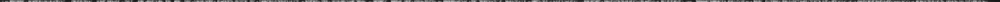

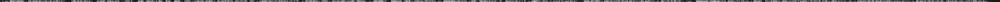

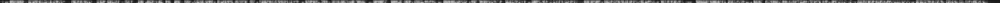

In [13]:
test_files = ["/Users/therold/Uni/master-thesis/evaluation/test_samples/german0.wav", "/Users/therold/Uni/master-thesis/evaluation/test_samples/german0_slow.wav", "/Users/therold/Uni/master-thesis/evaluation/test_samples/german0_fast.wav"]

for file in test_files:
    
    signal, sample_rate = read_wav_dirty(file)
    mel_image = spectrogram(signal, sample_rate)
    show_array(mel_image)


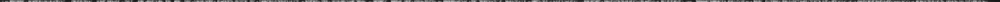

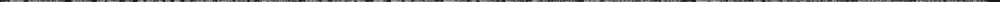

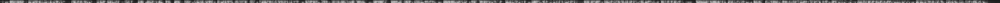

In [16]:
scales = [1, 0.9, 1.1]

for scale in scales:
    
    signal, sample_rate = read_wav_dirty("/Users/therold/Uni/master-thesis/evaluation/test_samples/german0.wav")
    mel_image = spectrogram(signal, scale * sample_rate)
    show_array(mel_image)


In [15]:
import IPython.display

y, sr   = librosa.load(test_files[0])
y_slow = librosa.effects.time_stretch(y, 0.9)
y_fast = librosa.effects.time_stretch(y, 1.1)

IPython.display.display(
    IPython.display.Audio(data=y, rate=sr), 
    IPython.display.Audio(data=y, rate=0.9 * sr), 
    IPython.display.Audio(data=y, rate=1.1 * sr), 
    IPython.display.Audio(data=y_slow, rate=sr), 
    IPython.display.Audio(data=y_fast, rate=sr)
)